In [ ]:
#!pip install -U albumentations 

     |████████████████████████████████| 102 kB 8.1 MB/s 
     |████████████████████████████████| 47.8 MB 91 kB/s 
  Attempting uninstall: albumentations
    Found existing installation: albumentations 0.1.12
    Uninstalling albumentations-0.1.12:
      Successfully uninstalled albumentations-0.1.12


In [ ]:
from google.colab import drive
drive.mount("/content/gdrive")

Mounted at /content/gdrive


In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Thu Apr 28 23:27:26 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   40C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
import shutil

In [ ]:
#shutil.copyfile("/content/gdrive/MyDrive/stat430project/semantic2d/data_2d_semantics.7z", "/content/data_2d_semantics.7z")
!7z x "/content/gdrive/MyDrive/stat430project/semantic2d/data_2d_semantics.7z" -o"/content/"


7-Zip [64] 16.02 : Copyright (c) 1999-2016 Igor Pavlov : 2016-05-21
p7zip Version 16.02 (locale=en_US.UTF-8,Utf16=on,HugeFiles=on,64 bits,2 CPUs Intel(R) Xeon(R) CPU @ 2.20GHz (406F0),ASM,AES-NI)

Scanning the drive for archives:
  0M Scan /content/gdrive/MyDrive/stat430project/semantic2d/                                                            1 file, 53486976622 bytes (50 GiB)

Extracting archive: /content/gdrive/MyDrive/stat430project/semantic2d/data_2d_semantics.7z
--
Path = /content/gdrive/MyDrive/stat430project/semantic2d/data_2d_semantics.7z
Type = 7z
Physical Size = 53486976622
Headers Size = 1018194
Method = LZMA2:26
Solid = +
Blocks = 4

  0%      0% 12 - data_2d_semantics/KITTI-360/data_2d_raw_train/0004.png                                                                

In [ ]:
# find -name '*.png' | sort -n | # find pngs
# gawk 'BEGIN{ a=1 }{ printf "mv %s %04d.png\n", $0, a++ }' | # build mv command
# bash

In [ ]:
#!cd /content/ && bash /content/gdrive/MyDrive/stat430project/semantic2d/download_2d_perspective.sh

In [ ]:
# !wget "https://s3.eu-central-1.amazonaws.com/avg-projects/KITTI-360/ed180d24c0a144f2f1ac71c2c655a3e986517ed8/data_2d_semantics.zip"
# Pre-process this data so that only the images we  need are there

In [ ]:
# Move zip from drive to local environment
# so that data extraction is easier
#import shutil
#shutil.copyfile("data_2d_semantics.zip", "/content/data_2d_semantics.zip")
#!unzip -q "/content/data_2d_semantics.zip" -d "/content/"

In [ ]:
#pip install git+https://github.com/autonomousvision/kitti360Scripts.git

In [ ]:
#!wget -P "/content/gdrive/MyDrive/stat430project" "https://raw.githubusercontent.com/autonomousvision/kitti360Scripts/master/kitti360scripts/helpers/labels.py"

In [ ]:
#!wget -P "/content/gdrive/MyDrive/stat430project" "https://github.com/autonomousvision/kitti360Scripts/blob/master/kitti360scripts/helpers/annotation.py"

In [ ]:
!pip uninstall opencv-python-headless 
!pip install opencv-python-headless==4.1.2.30
!pip install -U opencv-python

Found existing installation: opencv-python-headless 4.1.2.30
Uninstalling opencv-python-headless-4.1.2.30:
  Would remove:
    /usr/local/lib/python3.7/dist-packages/cv2/*
    /usr/local/lib/python3.7/dist-packages/opencv_python_headless-4.1.2.30.dist-info/*
  Would not remove (might be manually added):
    /usr/local/lib/python3.7/dist-packages/cv2/config-3.py
    /usr/local/lib/python3.7/dist-packages/cv2/config.py
    /usr/local/lib/python3.7/dist-packages/cv2/cv2.abi3.so
    /usr/local/lib/python3.7/dist-packages/cv2/gapi/__init__.py
    /usr/local/lib/python3.7/dist-packages/cv2/load_config_py2.py
    /usr/local/lib/python3.7/dist-packages/cv2/load_config_py3.py
    /usr/local/lib/python3.7/dist-packages/cv2/mat_wrapper/__init__.py
    /usr/local/lib/python3.7/dist-packages/cv2/misc/__init__.py
    /usr/local/lib/python3.7/dist-packages/cv2/misc/version.py
    /usr/local/lib/python3.7/dist-packages/cv2/qt/fonts/DejaVuSans-Bold.ttf
    /usr/local/lib/python3.7/dist-packages/cv2/qt/

In [ ]:
!pip install torchmetrics

     |████████████████████████████████| 408 kB 6.7 MB/s 


In [ ]:
import torch
from torchvision import datasets, transforms
import helper
from torch.utils.data import Dataset, DataLoader
import matplotlib.pyplot as plt
import numpy as np
import glob
import os
import cv2
import torch.nn as nn
import torchmetrics

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 4.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

%load_ext autoreload
%autoreload 2

In [ ]:
ignore_index = 0
void_classes = [0, 1, 2, 3, 4, 5, 6, 9, 10, 14, 15, 16, 18, 29, 30, 36, 38,
                39, 40, 41, 42, 43, 44, -1]

valid_classes = [ignore_index, 7, 8, 11, 12, 13, 17, 19, 20, 21, 22, 23,
                 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 37]

class_names = ["unlabelled", "road", "sidewalk", "building", "wall", "fence",
               "pole", "traffic light", "traffic sign", "vegetation",
               "terrain", "sky", "person", "rider", "car", "truck",
               "bus", "train", "motorcycle", "bicycle", "garage", "gate",
               "smallpole"]

class_map = dict(zip(valid_classes, range(len(valid_classes))))
n_classes = len(valid_classes)

In [ ]:
colors = [  [  0,  0,  0],
            [128, 64,128],    # 1  # road
            [244, 35,232],    # 2  # sidewalk
            [ 70, 70, 70],    # 3  # building
            [102,102,156],    # 4  # wall
            [190,153,153],    # 5  # fence
            [153,153,153],    # 6  # pole
            [250,170, 30],    # 7  # traffic light
            [220,220,  0],    # 8  # traffic sign
            [107,142, 35],    # 9  # vegatation
            [152,251,152],    # 10 # terrain
            [ 70,130,180],    # 11 # sky
            [220, 20, 60],    # 12 # person
            [255,  0,  0],    # 13 # rider
            [  0,  0,142],    # 14 # car
            [  0,  0, 70],    # 15 # truck
            [  0, 60,100],    # 16 # bus
            [  0, 80,100],    # 17 # train
            [  0,  0,230],    # 18 # motorcycle
            [119, 11, 32],    # 19 # bicycle
            [ 64,128,128],]   # 20 # garage
n_classes = len(colors)

In [ ]:
label_colors = dict(zip(range(n_classes), colors))
label_colors

{0: [0, 0, 0],
 1: [128, 64, 128],
 2: [244, 35, 232],
 3: [70, 70, 70],
 4: [102, 102, 156],
 5: [190, 153, 153],
 6: [153, 153, 153],
 7: [250, 170, 30],
 8: [220, 220, 0],
 9: [107, 142, 35],
 10: [152, 251, 152],
 11: [70, 130, 180],
 12: [220, 20, 60],
 13: [255, 0, 0],
 14: [0, 0, 142],
 15: [0, 0, 70],
 16: [0, 60, 100],
 17: [0, 80, 100],
 18: [0, 0, 230],
 19: [119, 11, 32],
 20: [64, 128, 128]}

In [ ]:
def decode_segmap(temp):
    #convert gray scale to color
    temp=temp.numpy()
    r = temp.copy()
    g = temp.copy()
    b = temp.copy()
    for l in range(0, n_classes):
        r[temp == l] = label_colors[l][0]
        g[temp == l] = label_colors[l][1]
        b[temp == l] = label_colors[l][2]

    rgb = np.zeros((temp.shape[0], temp.shape[1], 3))
    rgb[:, :, 0] = r / 255.0
    rgb[:, :, 1] = g / 255.0
    rgb[:, :, 2] = b / 255.0
    return rgb

In [ ]:
# import albumentations as A
# from albumentations.pytorch import ToTensorV2
# transform=A.Compose(
# [
#     A.Resize(256, 512),
#     A.HorizontalFlip(),
#     A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
#     A.pytorch.ToTensorV2(),
# ]
# )

In [ ]:
# transforms = transforms.Compose([
#   transforms.ToTensor(),
#   #transforms.Resize(int(1.15 * imsize)),
#   #transforms.RandomCrop(imsize),
#   #transforms.RandomHorizontalFlip(.5),
#   #transforms.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.1),
#   transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
# ])

In [ ]:
from PIL import Image
import numpy as np
import albumentations as A

In [ ]:
def image_show(data_loader,n):

  #Read Augmented image data
  data_iter = iter(data_loader)
  for i in range(1):
    images,labels = data_iter.next()

  #Convert image from tensor to numpy
  images = images.cpu().detach().numpy()

  #Take out n images one by one and display them
  for i in range(n):
    image = np.transpose(images[i],[1,2,0])
    plt.imshow(image, aspect='auto')
    plt.show()

In [ ]:
def mask_show(data_loader, n):

  #Read Augmented image data
  data_iter = iter(data_loader)
  for i in range(1):
    images,labels = data_iter.next()

  #Convert image from tensor to numpy
  labels = labels.cpu().detach().numpy()

  #Take out n images one by one and display them
  for i in range(n):
    #label = np.transpose(labels[i], [1,2,0])
    label = labels[i]
    print(label.shape)
    plt.imshow(label, aspect='auto')
    plt.show()

In [ ]:
inv_normalize = transforms.Normalize(
    mean=[-0.485/0.229, -0.456/0.224, -0.406/0.225],
    std=[1/0.229, 1/0.224, 1/0.255]
)

In [ ]:
# road = 0.3490               1 # 11
# sidewalk = 0.4706           2 # 11
# building = 0.2706           3 # 11
# wall = 0.4196               4 # 11
# fence = 0.6392              5 # 11
# pole = .6000                6 # 11
# traffic light = 0.6941      7 # 11 137
# traffic sign = 0.7607       8 # 11
# vegetation = 0.4667         9 # 11
# terrain = 0.8196            10 # 11
# sky = 0.4588                11 # 11
# person = 0.3255             12 # 64
# rider = 0.2941              13 # 88 55
# car = 0.0588                14 # 11
# truck = 0.0314              15 # 11
# bus = 0.1804                16 # 3705
# train = 0.22745             17 # 3361
# motorcycle = 0.1020         18 # 98
# bicycle = 0.1804            19 # 55 88 190
# garage = 0.4275             20 # 102

# mask[mask == 0.3529] = 1 # road
# mask[mask == 0.4706] = 2 # sidewalk
# mask[mask == 0.2745] = 3 # building
# mask[mask == 0.4235] = 4 # wall
# mask[mask == 0.6431] = 5 # fence
# mask[mask == 0.6000] = 6 # pole 
# mask[mask == 0.6980] = 7 # traffic light
# mask[mask == 0.7647] = 8 # traffic sign
# mask[mask == 0.4667] = 9 # vegatation
# mask[mask == 0.8235] = 10 # terrain
# mask[mask == 0.4627] = 11 # sky
# mask[mask == 0.3294] = 12 # person
# mask[mask == 0.2980] = 13 # rider
# mask[mask == 0.0627] = 14 # car
# mask[mask == 0.0314] = 15 # truck
# mask[mask == 0.1843] = 16 # bus
# mask[mask == 0.2275] = 17 # train
# mask[mask == 0.1020] = 18 # motorcycle
# mask[mask == 0.1804] = 19 # bicycle
# mask[mask == 0.4275] = 20 # garage
# mask[mask < 1] = 0

3700


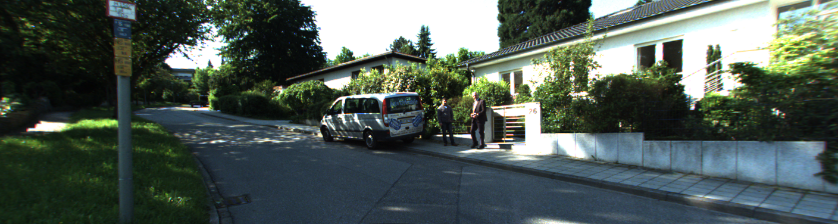

3701


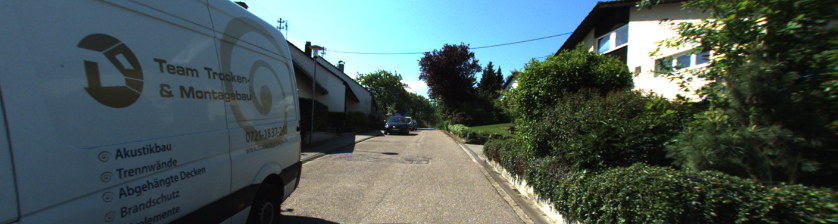

3702


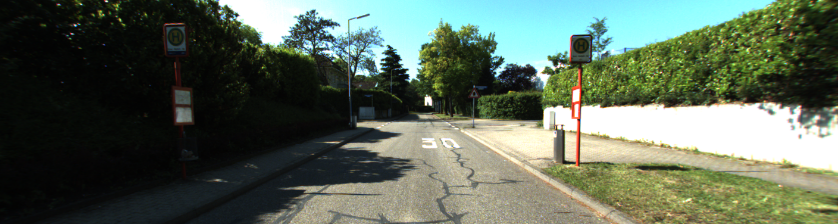

3703


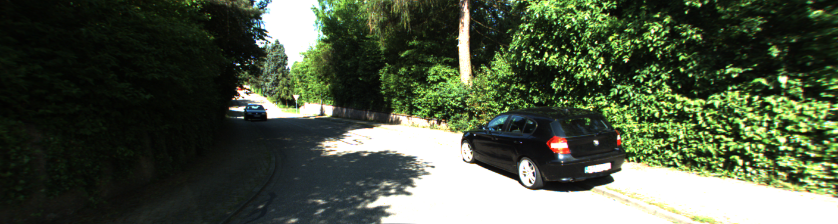

3704


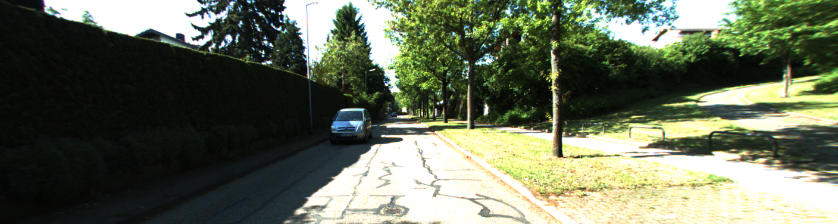

3705


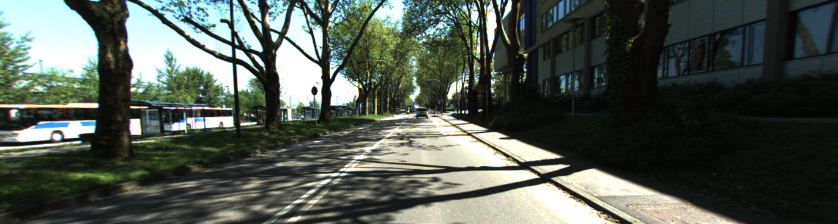

3706


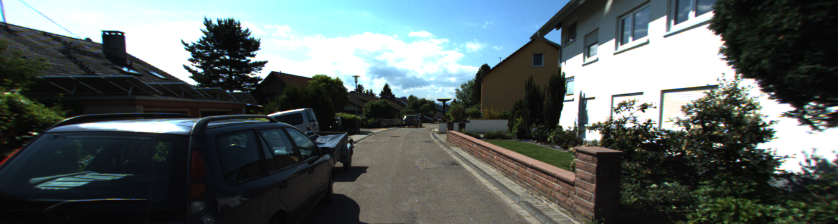

3707


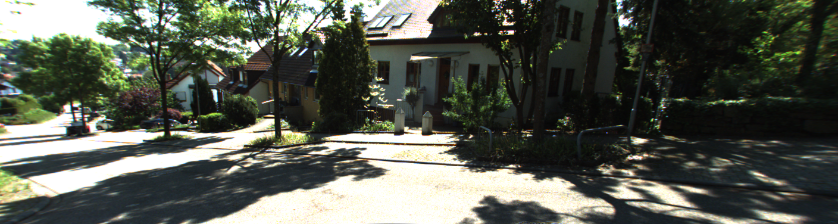

3708


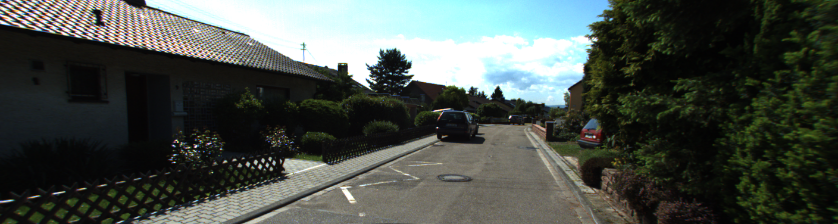

3709


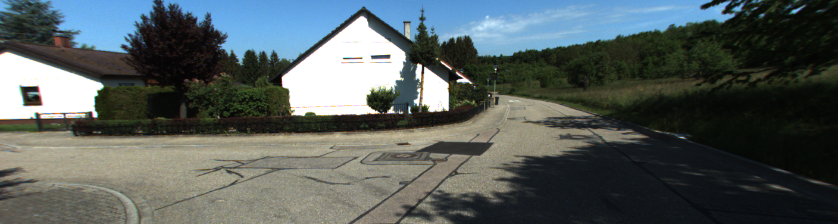

3710


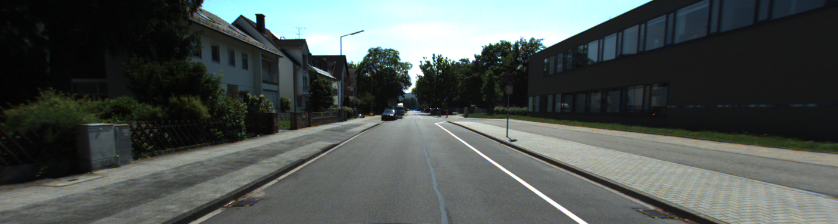

3711


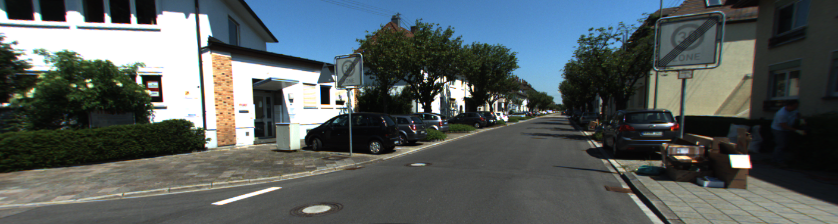

3712


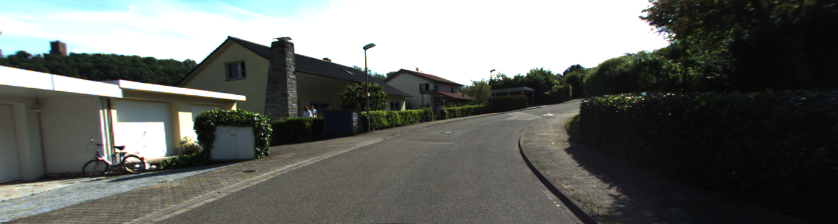

3713


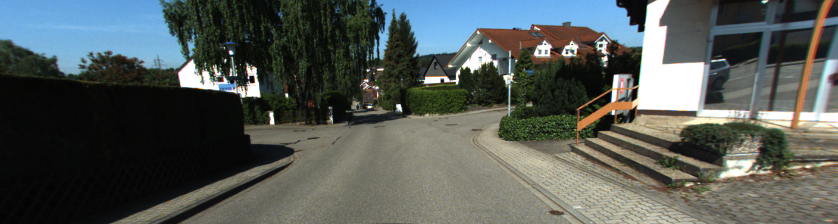

3714


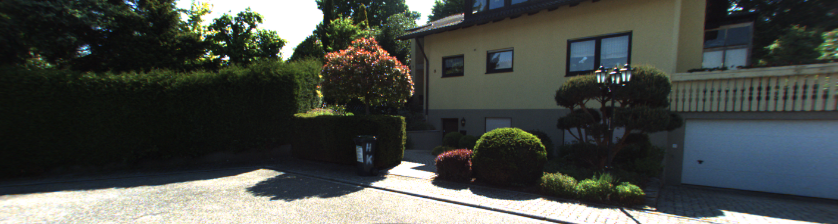

3715


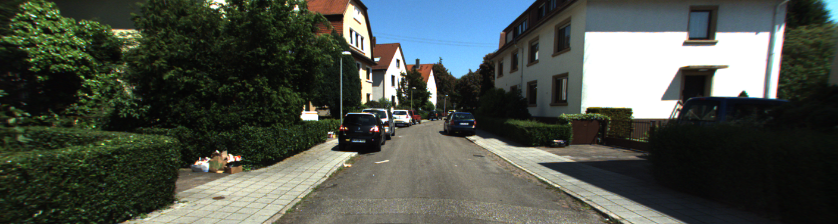

3716


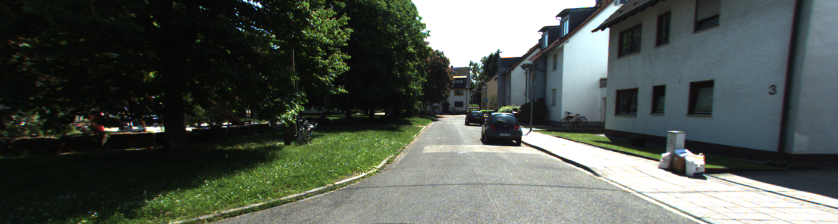

3717


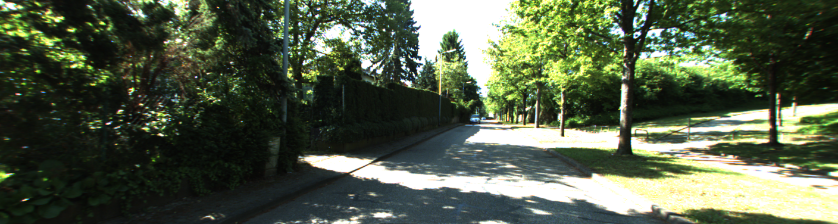

3718


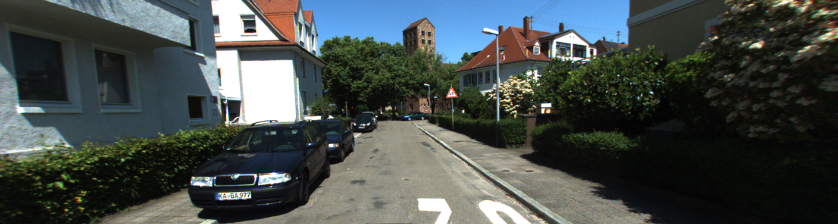

3719


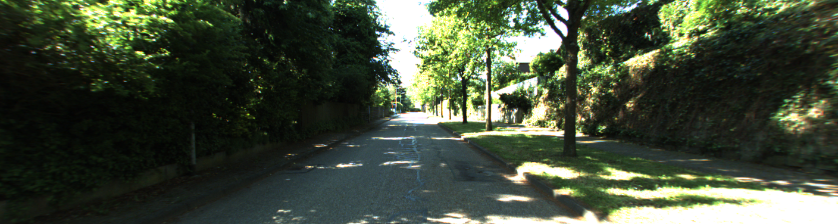

3720


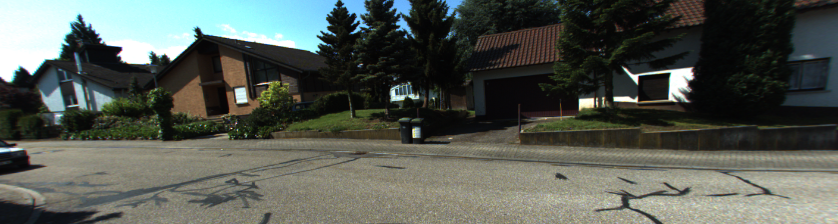

3721


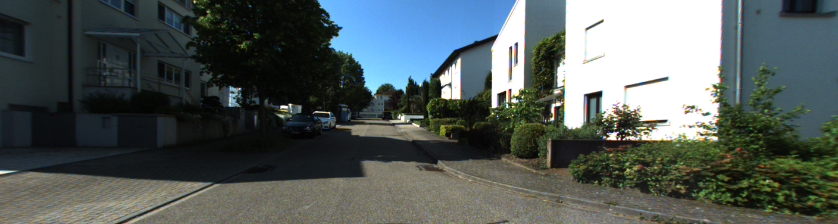

3722


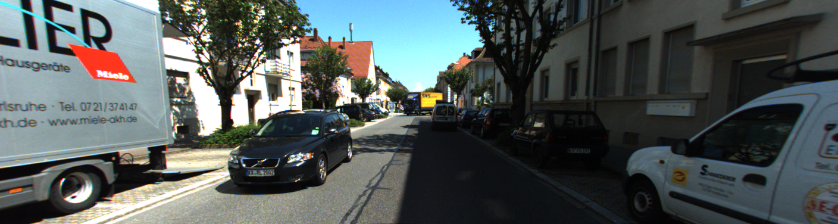

3723


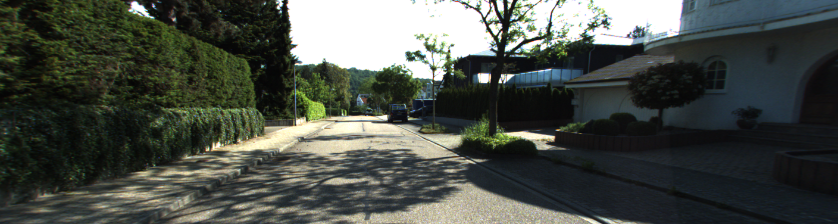

3724


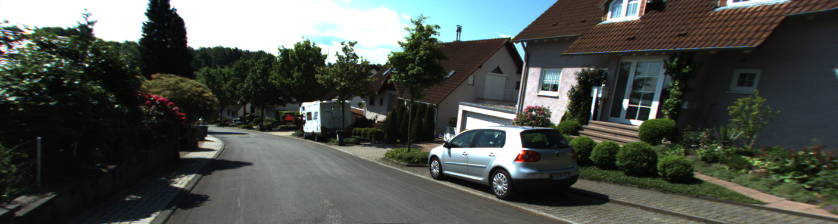

3725


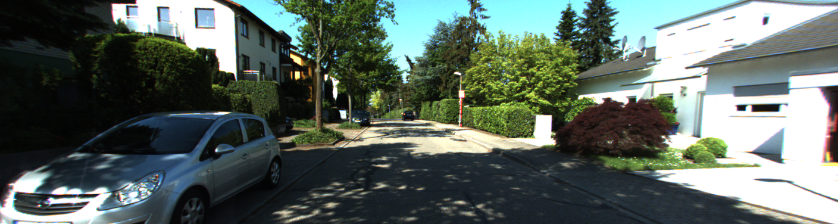

3726


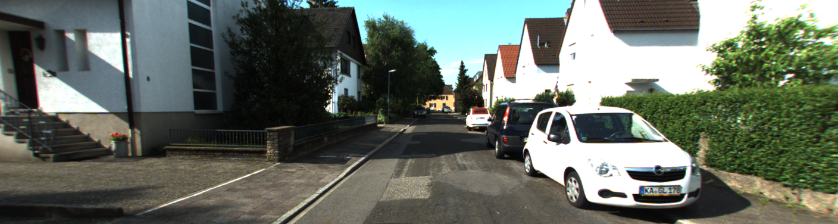

3727


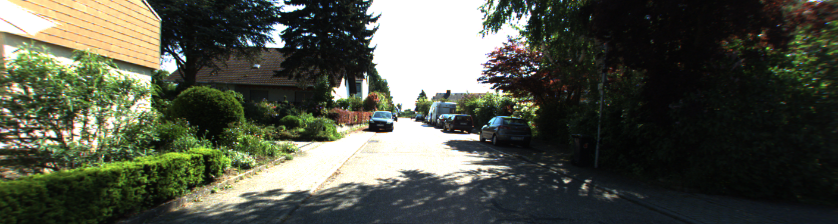

3728


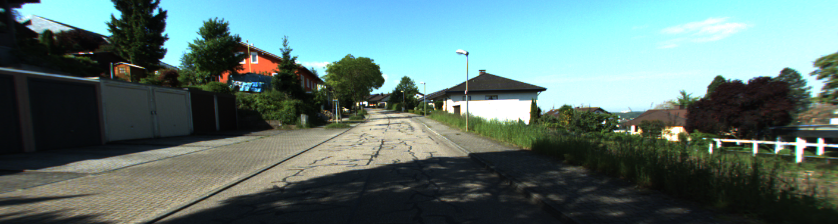

3729


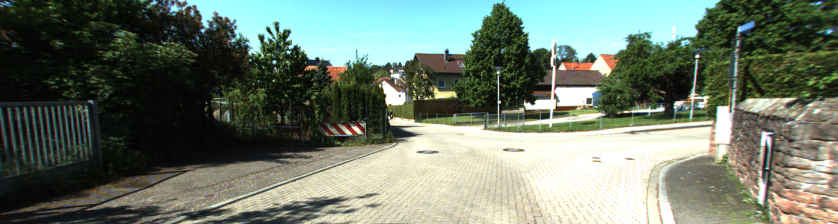

3730


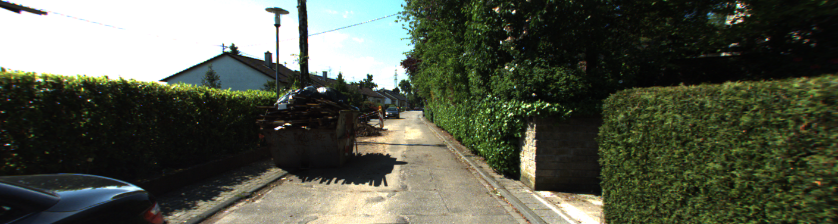

3731


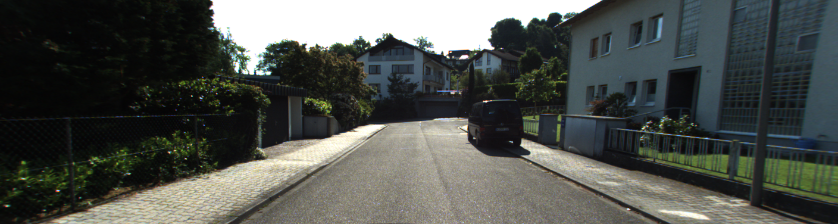

3732


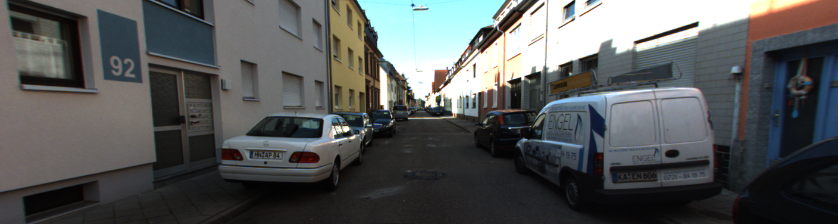

3733


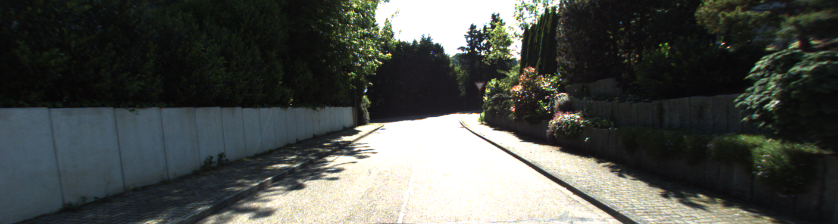

3734


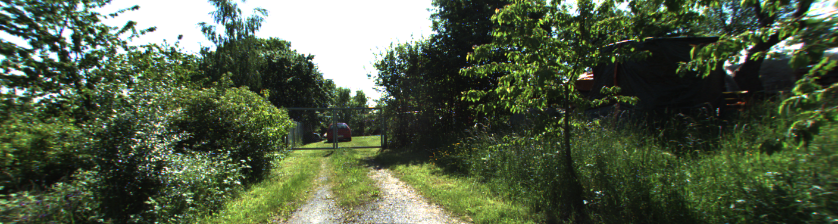

3735


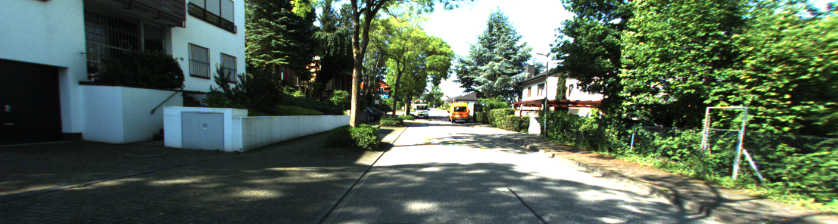

3736


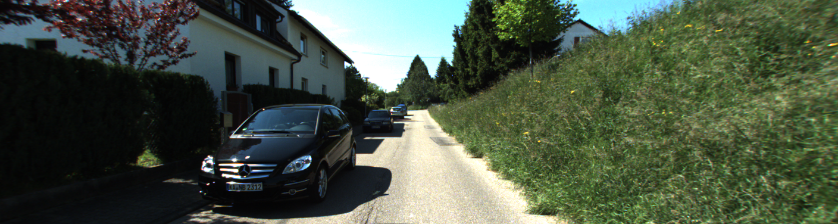

3737


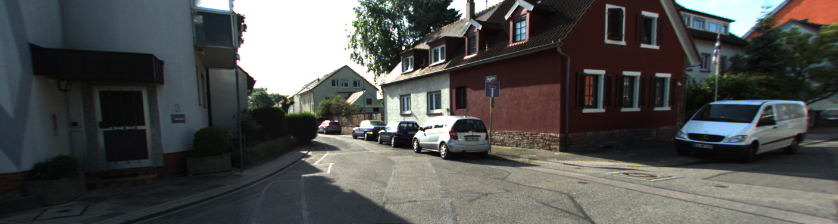

3738


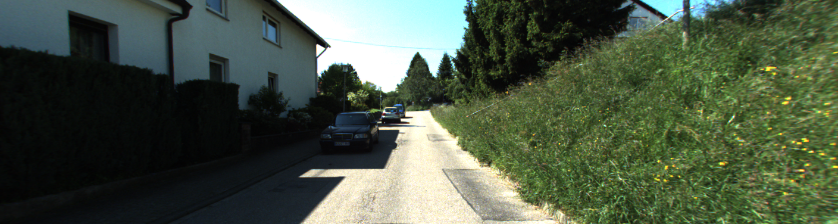

3739


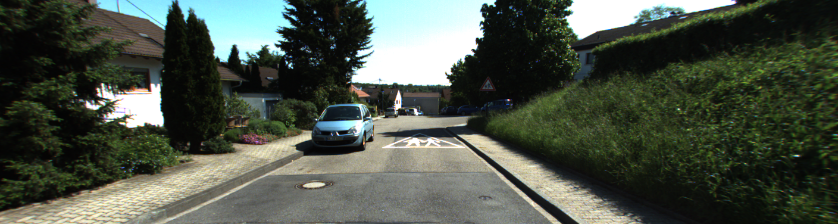

3740


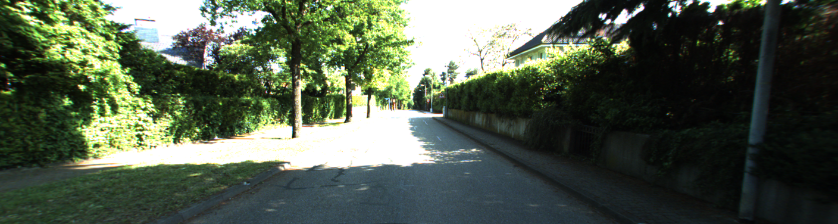

3741


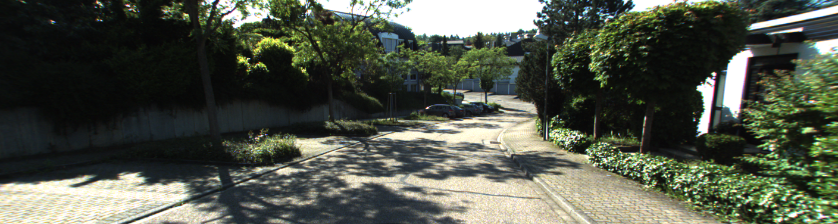

3742


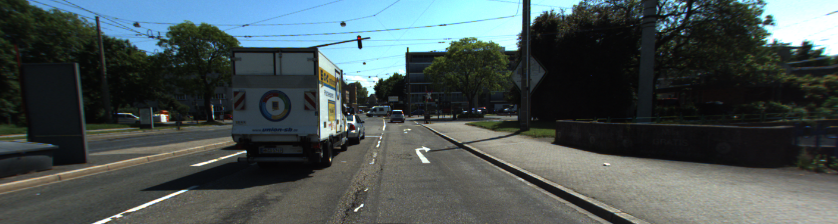

3743


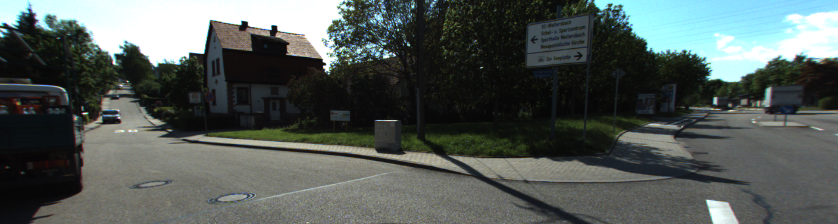

3744


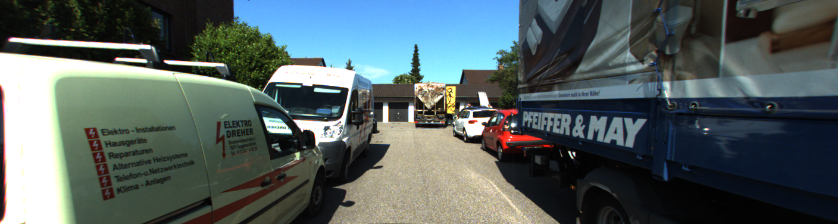

3745


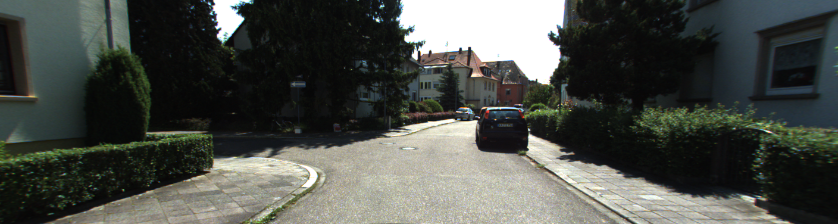

3746


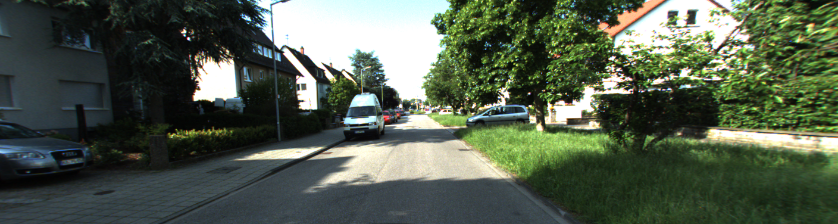

3747


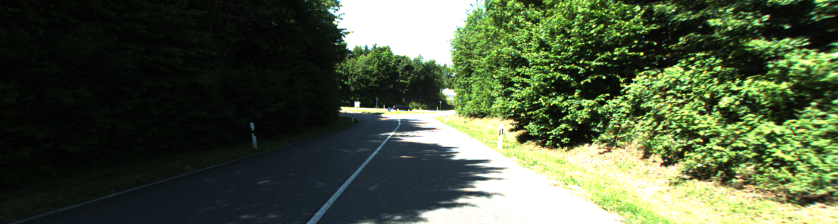

3748


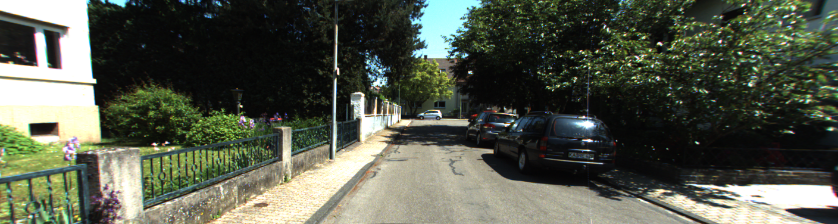

3749


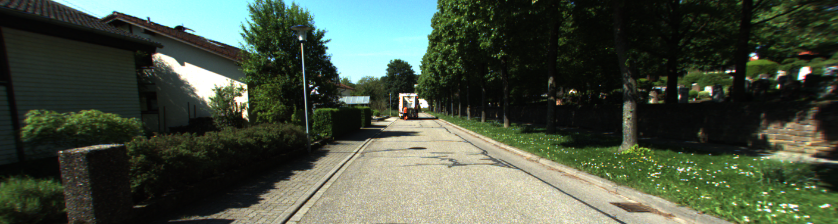

3750


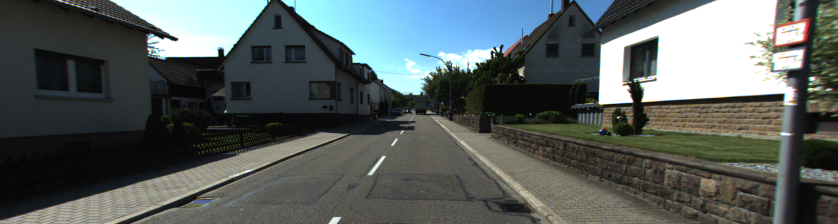

3751


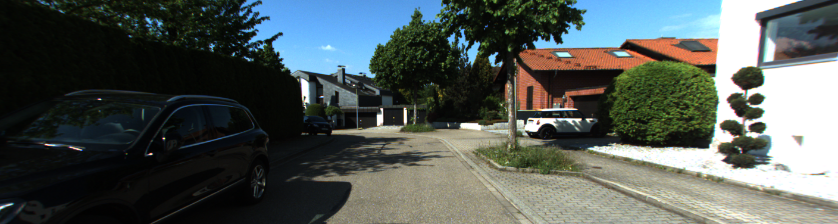

3752


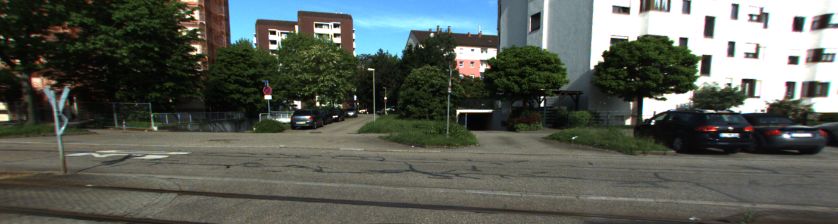

3753


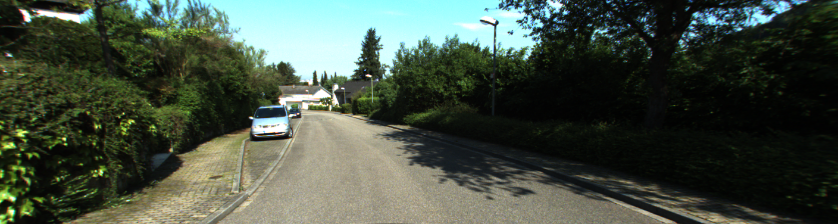

3754


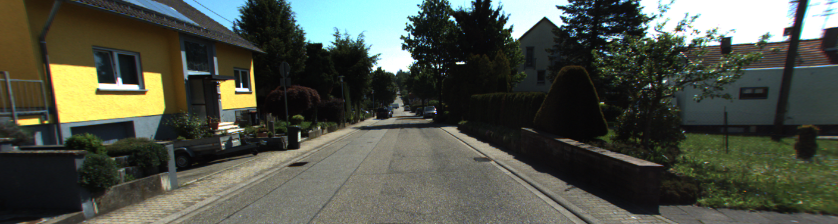

3755


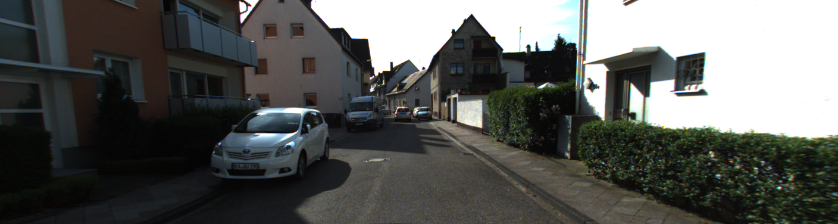

3756


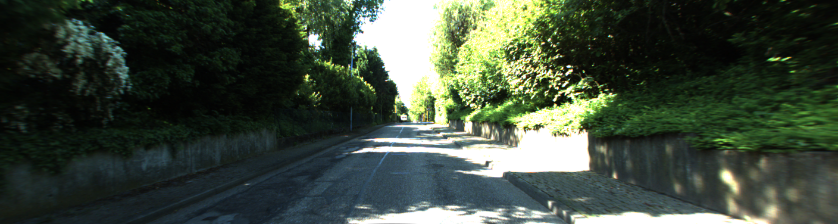

3757


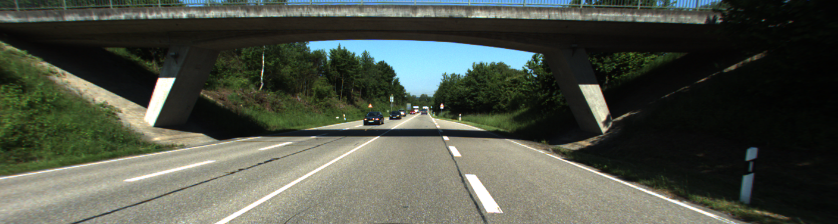

3758


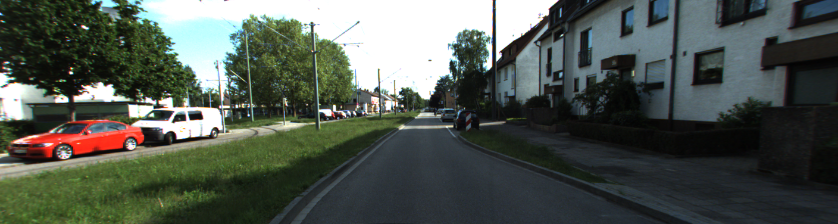

3759


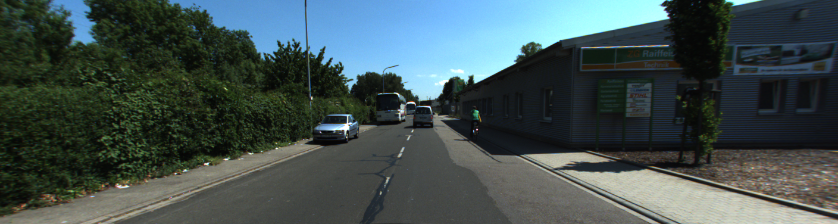

3760


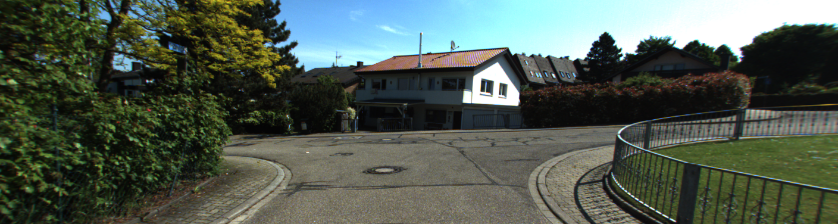

3761


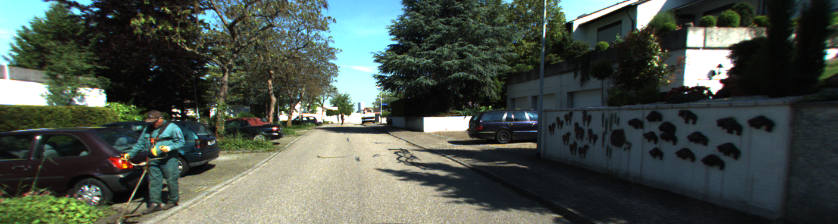

3762


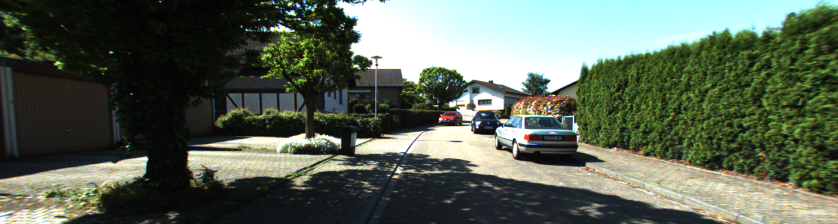

3763


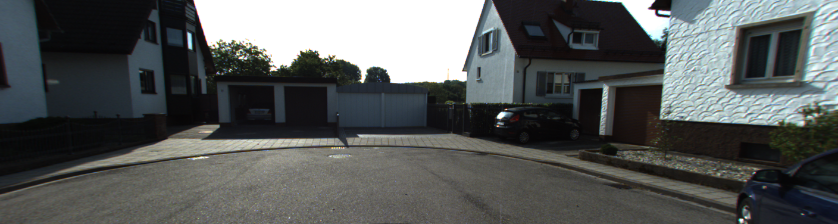

3764


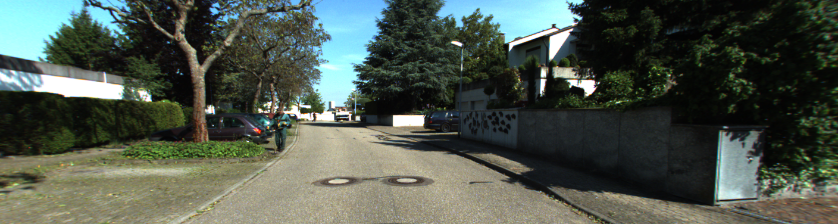

3765


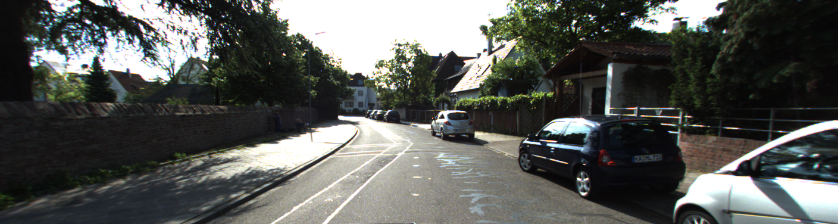

3766


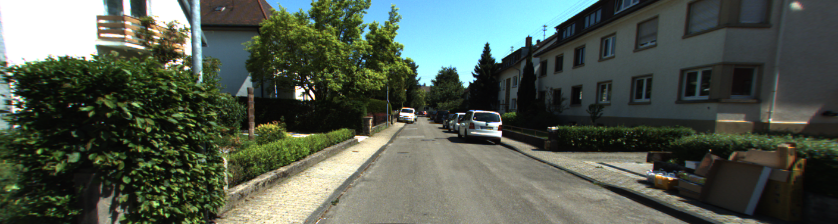

3767


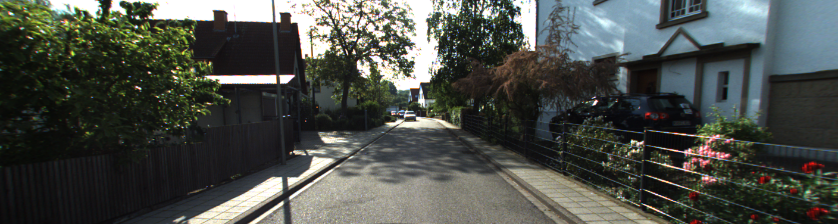

3768


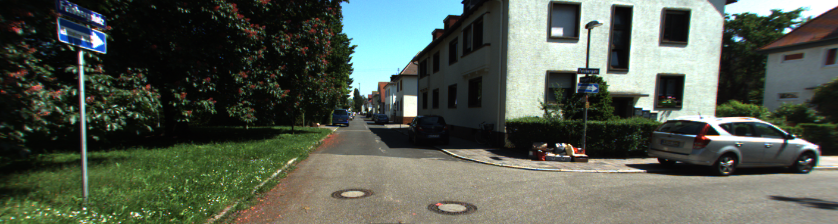

3769


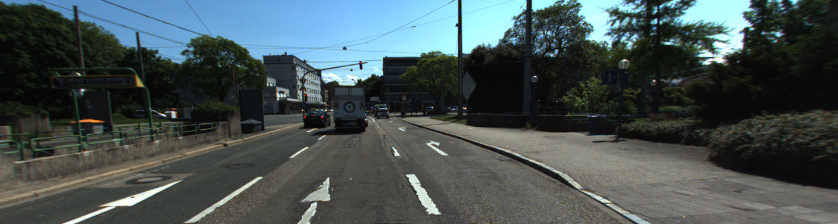

3770


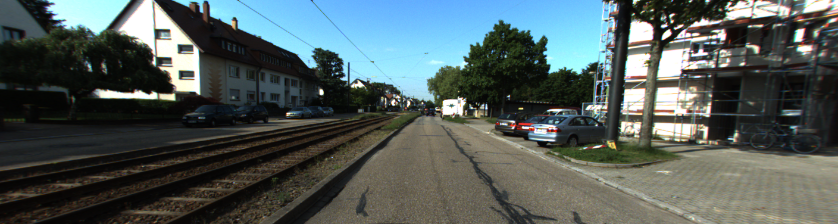

3771


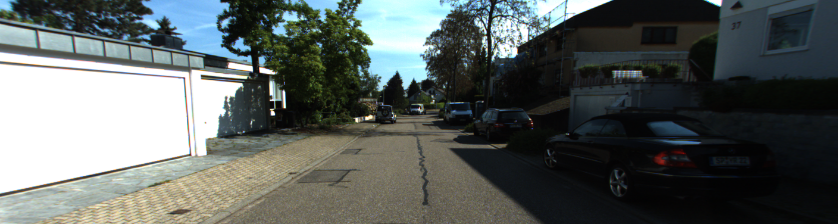

3772


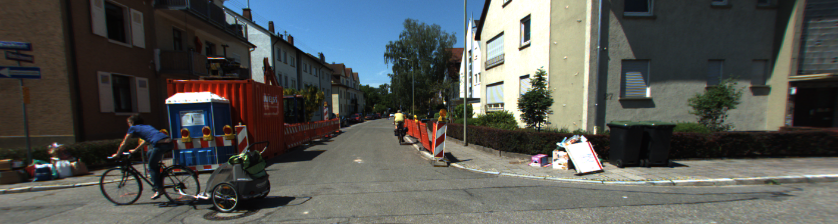

3773


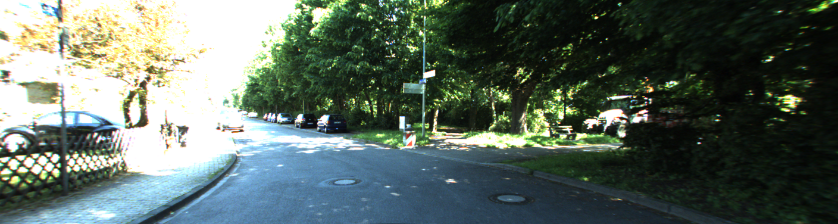

3774


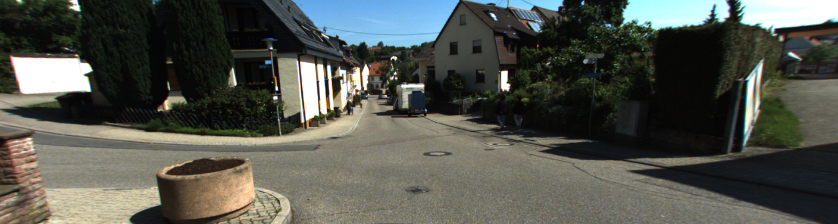

3775


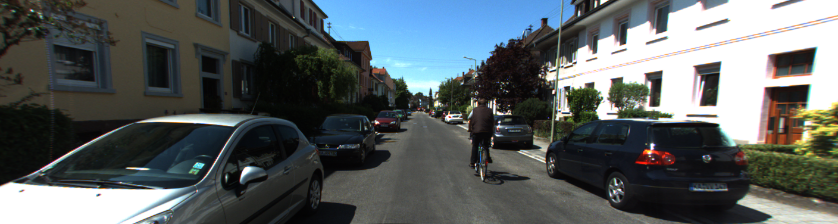

3776


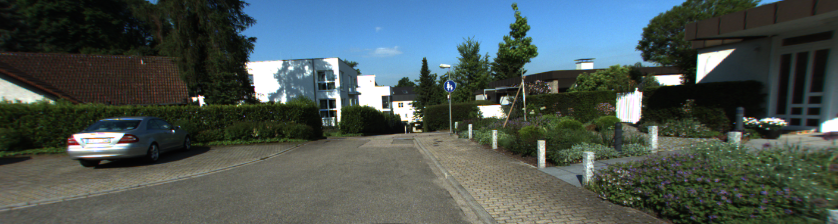

3777


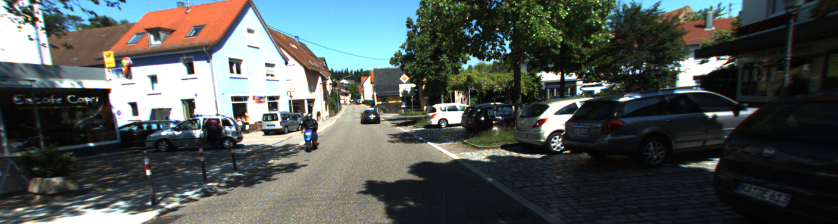

3778


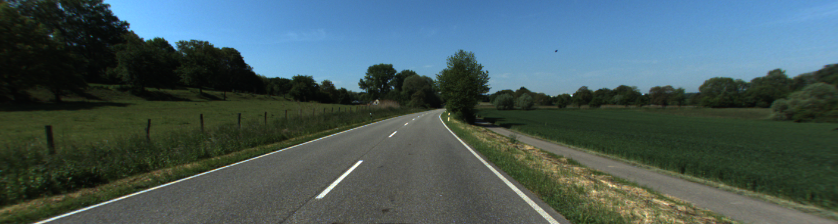

3779


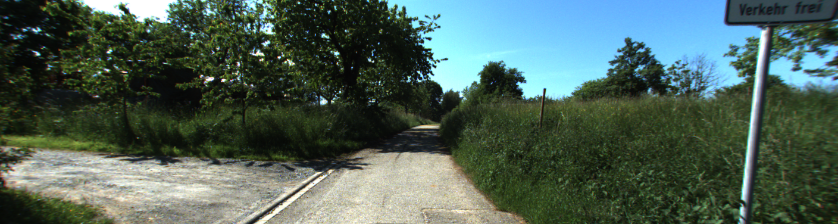

3780


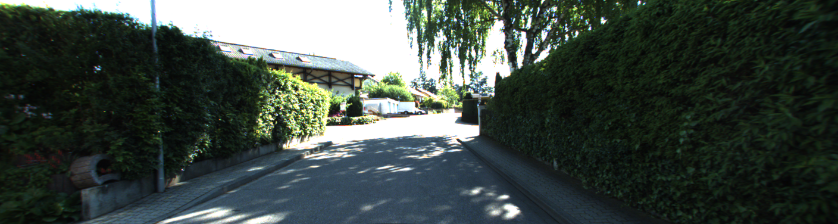

3781


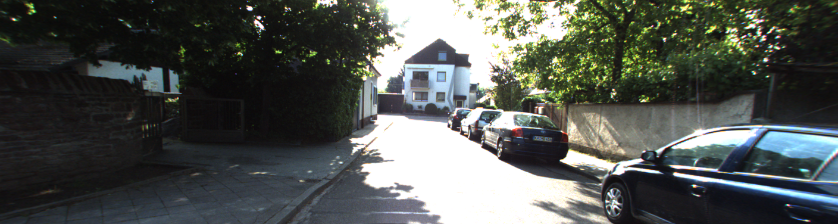

3782


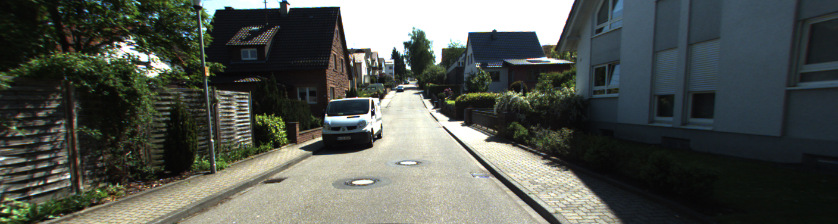

3783


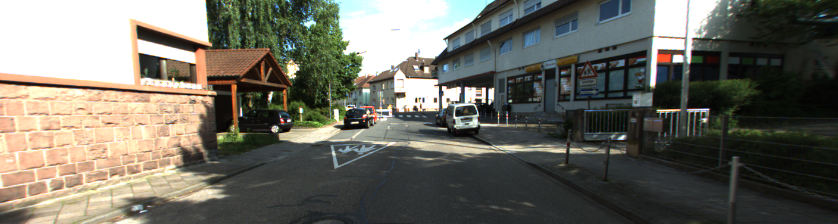

3784


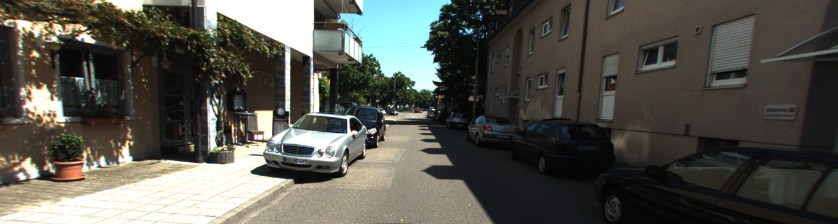

3785


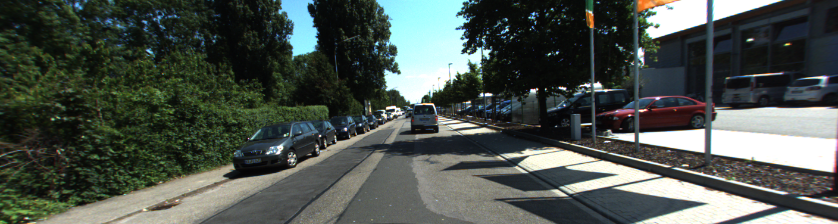

3786


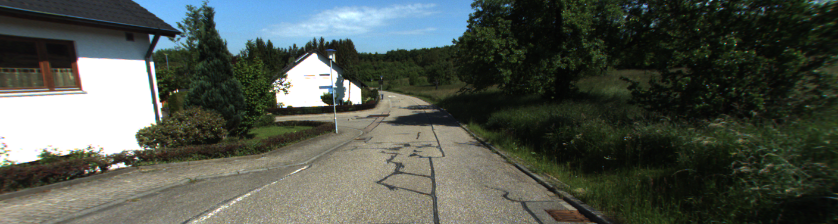

3787


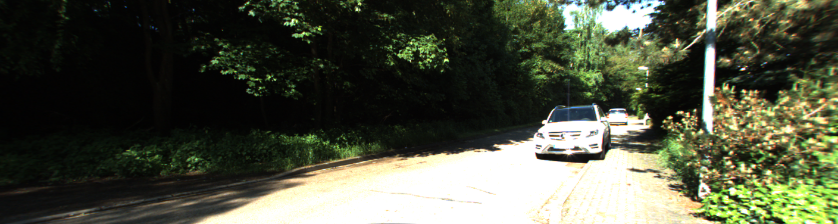

3788


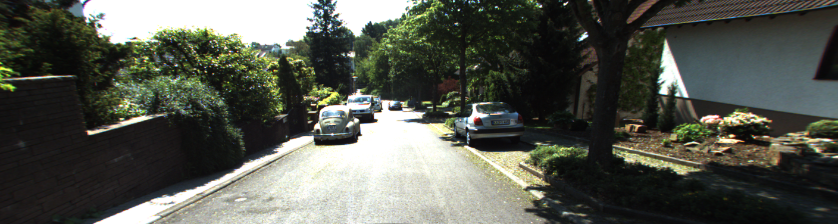

3789


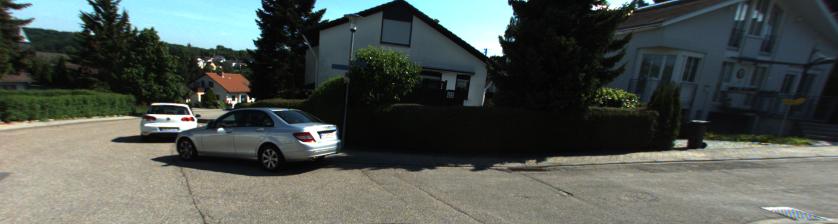

3790


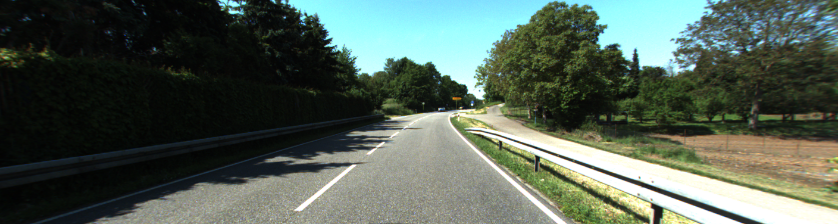

3791


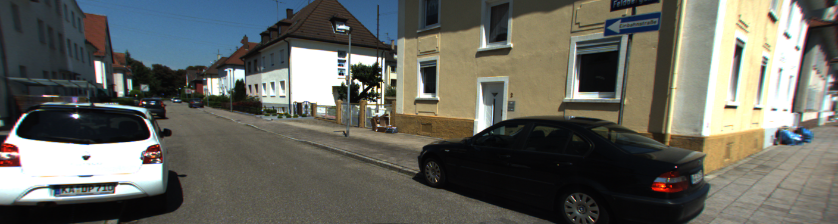

3792


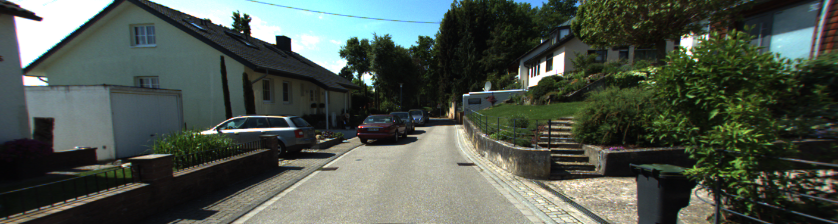

3793


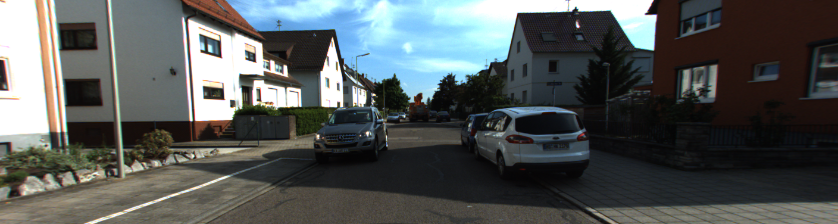

3794


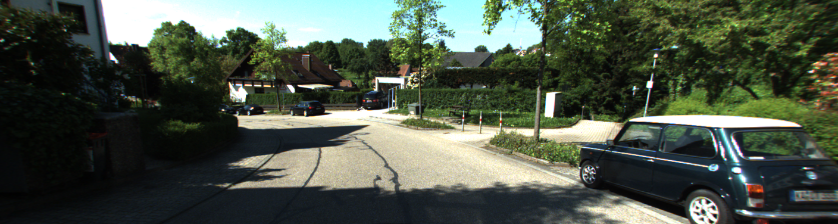

3795


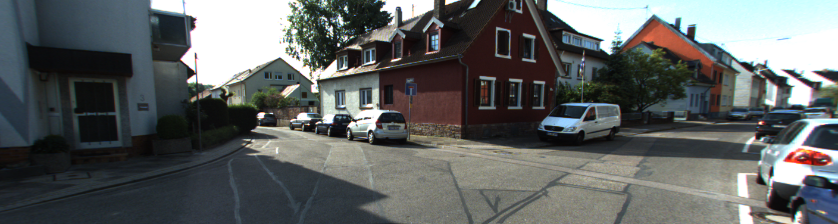

3796


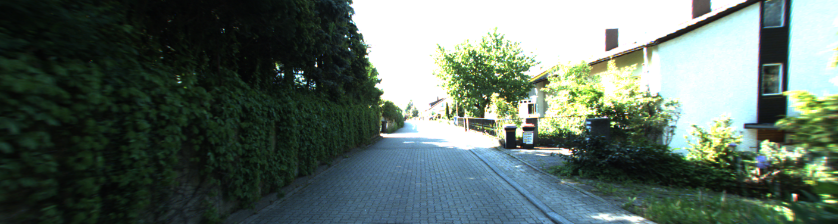

3797


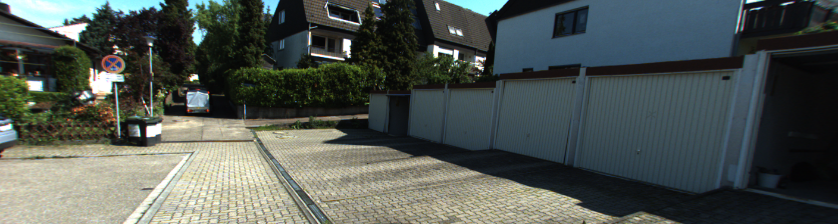

3798


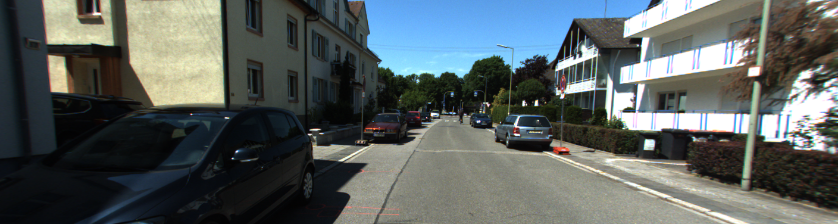

3799


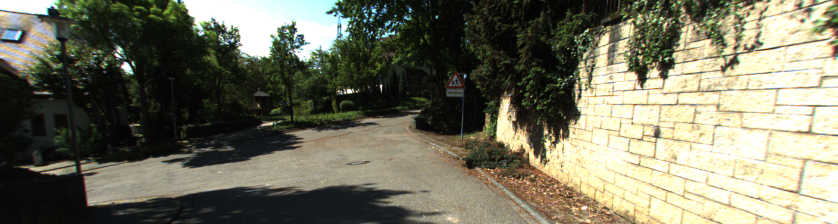

In [ ]:
for i in range(3700,3800):
  e_test, seg_encode = train_dataset[i]  #1175 1268


  img = transforms.ToPILImage()(e_test)
  print(i)
  display(img)

torch.Size([3, 224, 838]) torch.Size([3, 376, 1408])


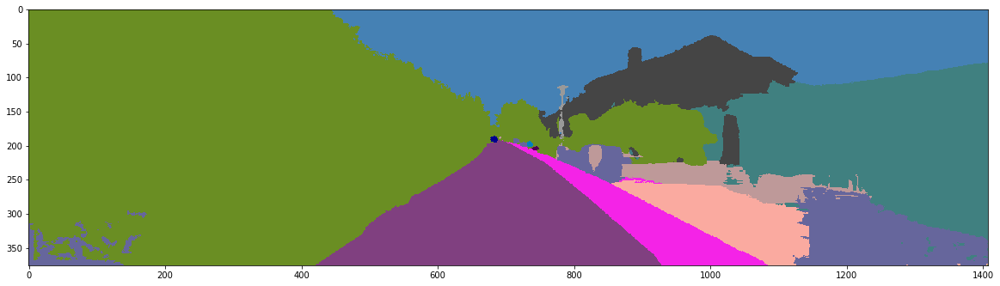

In [ ]:
encode_test,seg_encode = train_dataset[102]
print(encode_test.shape,seg_encode.shape)
plt.figure(figsize=(20,10))
plt.imshow(seg_encode.permute(1, 2, 0))

In [ ]:
transform = transforms.Compose([
                        #transforms.Resize(224),
                        #transforms.RandomCrop(imsize),
                        #transforms.RandomHorizontalFlip(.5),
                        #transforms.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.1),
                        ])

In [ ]:
np.mean([46,46,46], -1) / 255

0.1803921568627451

In [ ]:
torch.manual_seed(0)

In [ ]:
class KittiDataset(Dataset):
  def __init__(self, image_dir, mask_dir, transform=None):
    self.image_dir = image_dir
    self.mask_dir = mask_dir
    self.transform = transform
    self.images = os.listdir(image_dir)

  def __len__(self):
    return len(self.images)

  def __getitem__(self, index):
    img_path = os.path.join(self.image_dir, self.images[index])
    mask_path = os.path.join(self.mask_dir, self.images[index])
    image = np.array(Image.open(img_path).convert("RGB"))
    mask = np.array(Image.open(mask_path).convert("L"))

    # default size of images is 3 x 1408 x 376
    #try to get albumentations working for better transform applies

    if self.transform is not None:
      Norm = transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
      tens = transforms.ToTensor()
      #augmentations = transforms(image=image, mask=mask)
      #image = augmentations["image"]
      #mask = augmentations["mask"]
      image = tens(image)
      mask = tens(mask).round(decimals=4)

      image = Norm(image)
      #image = transform(image)
      #mask = transform(mask).squeeze(0)
      mask = mask.squeeze(0)
      mask[mask == 0.3529] = 1 # road
      mask[mask == 0.4706] = 2 # sidewalk
      mask[mask == 0.2745] = 3 # building
      mask[mask == 0.4235] = 4 # wall
      mask[mask == 0.6431] = 5 # fence
      mask[mask == 0.6000] = 6 # pole 
      mask[mask == 0.6980] = 7 # traffic light
      mask[mask == 0.7647] = 8 # traffic sign
      mask[mask == 0.4667] = 9 # vegatation
      mask[mask == 0.8235] = 10 # terrain
      mask[mask == 0.4627] = 11 # sky
      mask[mask == 0.3294] = 12 # person
      mask[mask == 0.2980] = 13 # rider
      mask[mask == 0.0627] = 14 # car
      mask[mask == 0.0314] = 15 # truck
      mask[mask == 0.1843] = 16 # bus
      mask[mask == 0.2275] = 17 # train
      mask[mask == 0.1020] = 18 # motorcycle
      mask[mask == 0.1804] = 19 # bicycle
      mask[mask == 0.4275] = 20 # garage
      mask[mask < 1] = 0


    
    return image, mask

In [ ]:
data_2d_train_root = "/content/data_2d_semantics/KITTI-360/data_2d_raw_train"
mask_2d_train_root = "/content/data_2d_semantics/KITTI-360/semantic_mask_train"

data_2d_val_root = "/content/data_2d_semantics/KITTI-360/data_2d_raw_val"
mask_2d_val_root = "/content/data_2d_semantics/KITTI-360/semantic_mask_val"

In [ ]:
train_dataset = KittiDataset(image_dir=data_2d_train_root, mask_dir=mask_2d_train_root, transform=transforms)

val_dataset = KittiDataset(data_2d_val_root, mask_2d_val_root, transform=transforms)

In [ ]:
train_data = DataLoader(train_dataset, batch_size=8, shuffle=False, num_workers=1, drop_last=True)
val_data = DataLoader(val_dataset, batch_size=8, shuffle=False, num_workers=1, drop_last=True)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


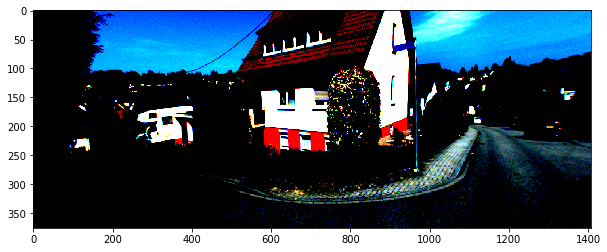

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


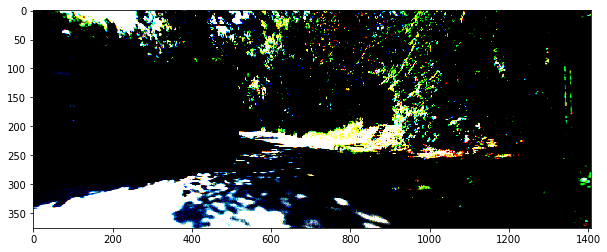

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


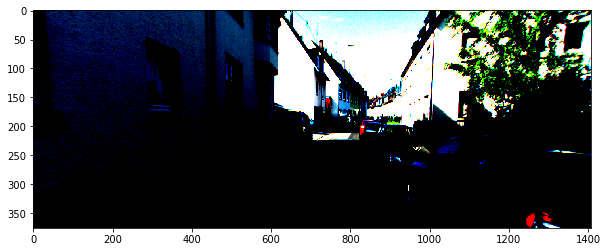

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


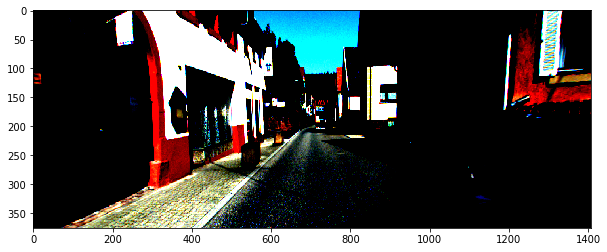

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


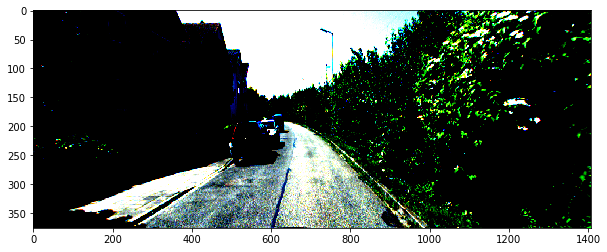

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


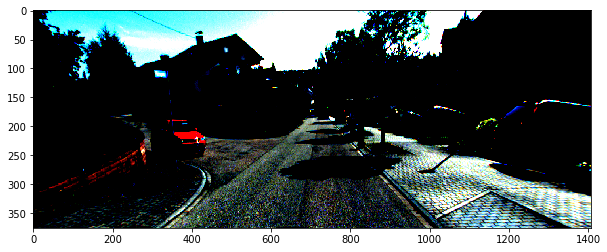

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


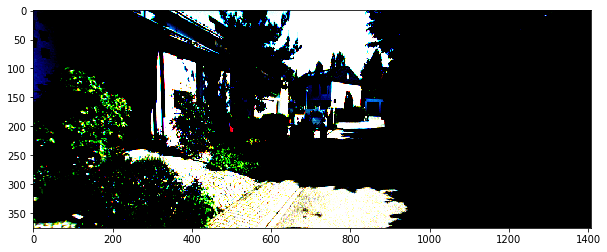

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


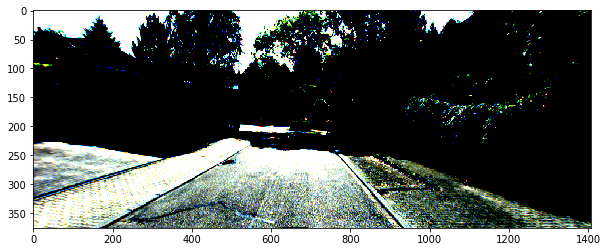

In [ ]:
image_show(train_data, 8)

(376, 1408)


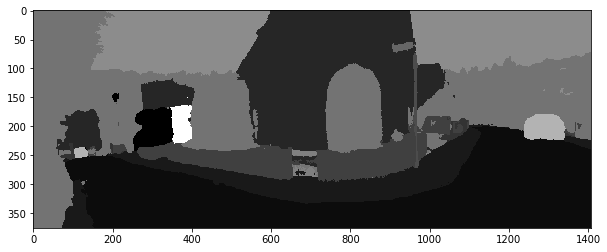

(376, 1408)


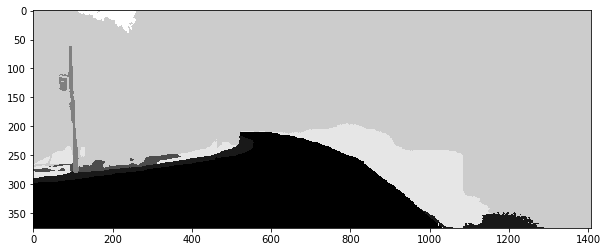

(376, 1408)


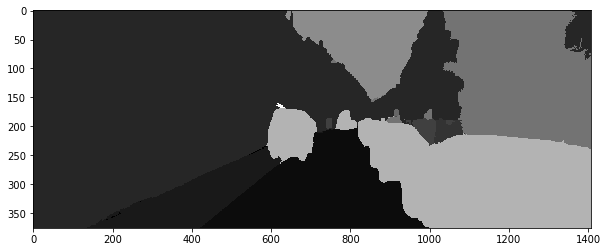

(376, 1408)


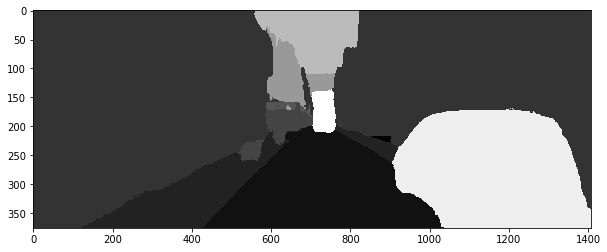

(376, 1408)


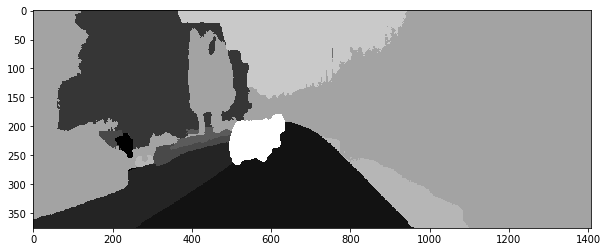

(376, 1408)


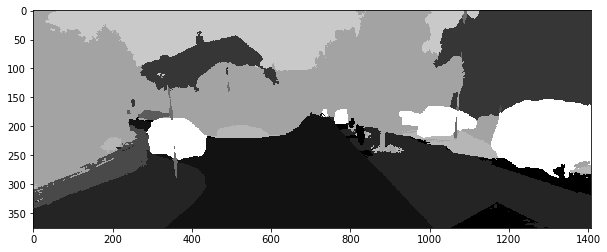

(376, 1408)


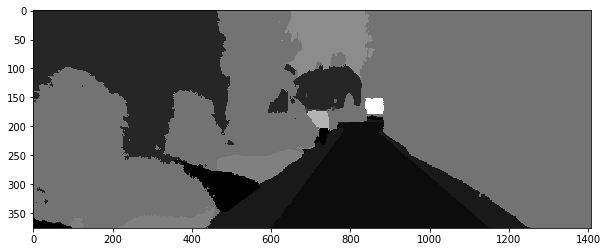

(376, 1408)


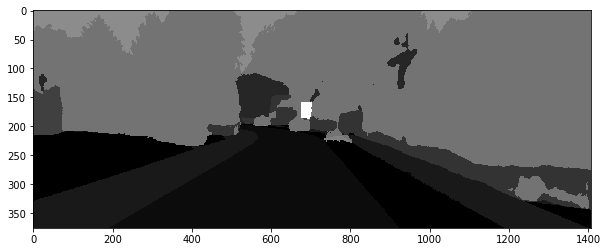

In [ ]:
mask_show(train_data, 8)

In [ ]:
encode_test,seg_encode = train_dataset[375]
print(encode_test.shape,seg_encode.shape)

torch.Size([3, 376, 1408]) torch.Size([376, 1408])


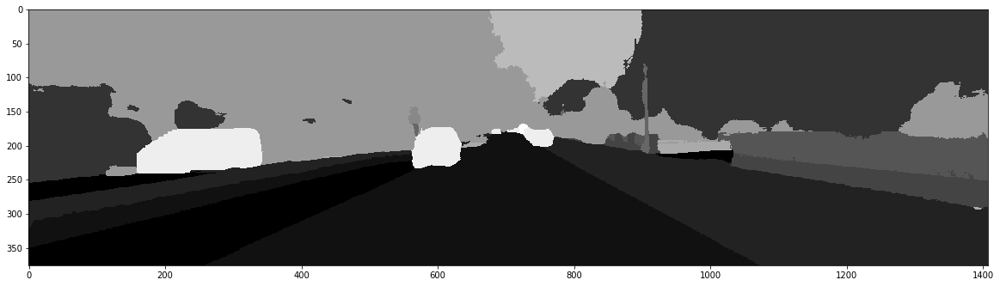

In [ ]:
plt.figure(figsize=(20,10))
plt.imshow(seg_encode)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


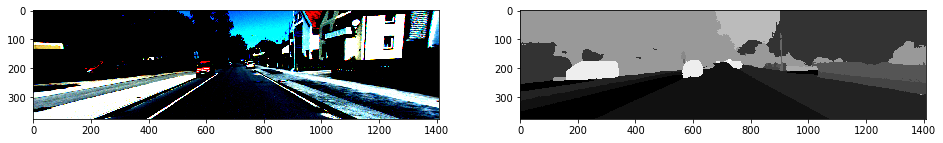

In [ ]:
fig,ax=plt.subplots(ncols=2,nrows=1,figsize=(16,8))
ax[0].imshow(encode_test.permute(1, 2, 0))
ax[1].imshow(seg_encode,cmap='gray')

In [ ]:
#class labels before label correction
print(torch.unique(seg_encode))
print(len(torch.unique(seg_encode)))

tensor([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  8.,  9., 10., 11., 14., 15.])
13


In [ ]:
torch.from_numpy(decode_segmap(seg_encode)).permute(2,0,1).shape

torch.Size([3, 376, 1408])

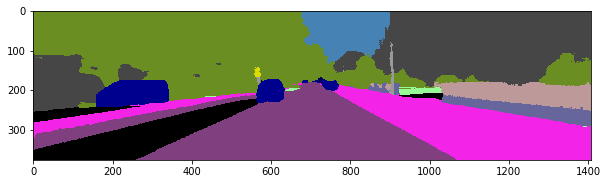

In [ ]:
plt.imshow(decode_segmap(seg_encode))

In [ ]:
# import gc
# gc.collect()
#torch.cuda.empty_cache()

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [ ]:
torch.cuda.is_available()

True

In [ ]:
!rm -r /root/.cache/torch/hub/

In [ ]:
num_epochs = 3

# Load Pretrained DeepLabsV3
classifier = torch.hub.load('pytorch/vision:v0.10.0', 'deeplabv3_resnet50', pretrained=True)

Downloading: "https://github.com/pytorch/vision/archive/v0.10.0.zip" to /root/.cache/torch/hub/v0.10.0.zip


In [ ]:
classifier.eval()

DeepLabV3(
  (backbone): IntermediateLayerGetter(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Se

In [ ]:
for param in classifier.parameters():
  param.requires_grad = False

In [ ]:
classifier.classifier[4] = nn.Conv2d(256, 21, kernel_size=(1,1), stride=(1,1))

In [ ]:
classifier.classifier[4]

Conv2d(256, 21, kernel_size=(1, 1), stride=(1, 1))

In [ ]:
classifier.classifier[1].requires_grad = True
classifier.classifier[2].requires_grad = True
classifier.classifier[3].requires_grad = True
classifier.classifier[4].requires_grad = True

In [ ]:
classifier.aux_classifier[4] = nn.Conv2d(256, 21, kernel_size=(1,1), stride=(1,1))
classifier.aux_classifier[4].requires_grad = True

In [ ]:
classifier = classifier.to(device)
optimizer = torch.optim.Adam(classifier.parameters(), lr=1e-5)
criterion = nn.CrossEntropyLoss(ignore_index=0)

In [ ]:
def plot_losses(train, val, num_epochs):
    indices = np.arange(num_epochs)
    plt.plot(indices, train, label="train")
    plt.plot(indices, val, label="val")
    plt.title("Loss Plot")
    plt.ylabel("Loss")
    plt.xlabel("Epoch")
    plt.legend()
    plt.show()

In [ ]:
losses = []
val_loss = []
train_iou_epochs = []
val_iou_epochs = []

train_iou = torchmetrics.JaccardIndex(num_classes=n_classes, compute_on_cpu=False).to(device)
val_iou = torchmetrics.JaccardIndex(num_classes=n_classes, compute_on_cpu=False).to(device)

classifier.train()
for epoch in range(num_epochs):
  # list to compute mean loss per epoch
  temp_loss = []
  temp_val_loss = []

  for batch_idx, (data_, masks_) in enumerate(train_data):
      # Put batch on GPU
      data_ = data_.to(device=device, dtype=torch.float32)
      targets = masks_.to(device=device, dtype=torch.long)

      #forward
      scores = classifier(data_)['out']

      # get loss, iou and append loss to list
      loss = criterion(scores, targets.long())
      train_iou.update(scores,targets)
      temp_loss.append(loss.item())

      #backward
      optimizer.zero_grad()
      loss.backward()

      optimizer.step()

  # compute mean loss and mIoU
  train_loss_epoch = sum(temp_loss) / len(temp_loss)
  train_iou_epoch = train_iou.compute()

  # append mean loss and mIoU
  losses.append(train_loss_epoch)
  train_iou_epochs.append(train_iou_epoch)

  # forward pass on 
  with torch.no_grad():
    for j, (input, target) in enumerate(val_data):
      input = input.to(device=device, dtype=torch.float32)
      target = target.to(device=device, dtype=torch.long)

      pred = classifier(input)['out']

      v_loss = criterion(pred, target.long())
      val_iou.update(pred, target)

      temp_val_loss.append(v_loss.item())

  val_loss_epoch = sum(temp_val_loss) / len(temp_val_loss)
  val_iou_epoch = val_iou.compute()
  val_loss.append(val_loss_epoch)
  val_iou_epochs.append(val_iou_epoch)


  print(f'Cost at epoch {epoch+1} is {train_loss_epoch}')
  print(f'IoU at epoch {epoch+1} is {train_iou_epoch}')
  print(f'Val Cost at epoch {epoch+1} is {val_loss_epoch}')
  print(f'IoU at epoch {epoch+1} is {val_iou_epoch}')

  #reset the metrics
  train_iou.reset()
  val_iou.reset()

Cost at epoch 1 is 1.8759844585924732
IoU at epoch 1 is 0.06713385134935379
Val Cost at epoch 1 is 1.4321709275245667
IoU at epoch 1 is 0.10673707723617554
Cost at epoch 2 is 1.2168036136919138
IoU at epoch 2 is 0.11729118227958679
Val Cost at epoch 2 is 1.1813838690946745
IoU at epoch 2 is 0.12366771697998047
Cost at epoch 3 is 1.0616770527800736
IoU at epoch 3 is 0.12781019508838654
Val Cost at epoch 3 is 1.0903886532146274
IoU at epoch 3 is 0.12909667193889618


In [ ]:
train_iou_epochs

[tensor(0.0435, device='cuda:0'), tensor(0.0435, device='cuda:0')]

In [ ]:
checkpoint = {
    "epoch": 2,
    "model_state": classifier.state_dict(),
    "optim_state": criterion.state_dict()
}

In [ ]:
torch.save(checkpoint, "/content/gdrive/MyDrive/stat430project/model.pth")

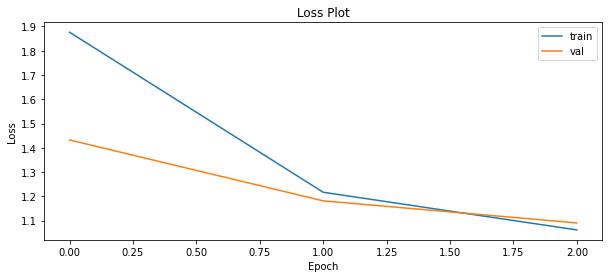

In [ ]:
plot_losses(losses, val_loss, num_epochs)

In [ ]:
def plot_iou(train, val, num_epochs):
    indices = np.arange(num_epochs)
    plt.plot(indices, train, label="train")
    plt.plot(indices, val, label="val")
    plt.title("IoU Plot")
    plt.ylabel("IoU")
    plt.xlabel("Epoch")
    plt.legend()
    plt.show()

In [ ]:
iou_list = [train_iou_epochs[0].cpu(),train_iou_epochs[1].cpu(),train_iou_epochs[2].cpu()]

In [ ]:
val_iou_list = [val_iou_epochs[0].cpu(),val_iou_epochs[1].cpu(),val_iou_epochs[2].cpu()]

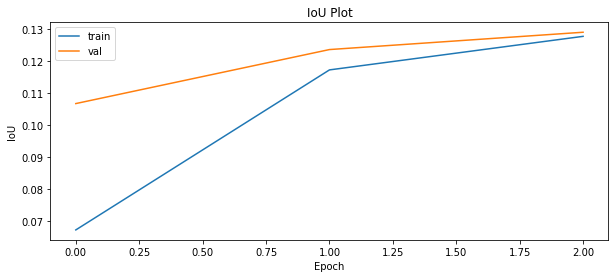

In [ ]:
plot_iou(iou_list, val_iou_list, num_epochs)

In [ ]:
classifier.eval()
with torch.no_grad():
    for batch in val_data:
        test_images,seg_test=batch
        output=classifier(test_images.cuda())['out']
        break
print(test_images.shape,seg_test.shape,output.shape)

torch.Size([8, 3, 376, 1408]) torch.Size([8, 376, 1408]) torch.Size([8, 21, 376, 1408])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


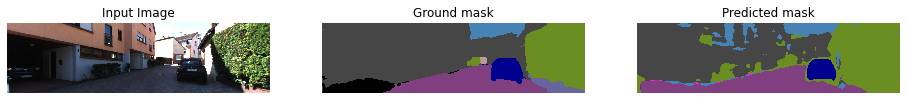

In [ ]:
sample=7
invimg=inv_normalize(test_images[sample])
outputx=output.detach().cpu()[sample]
encoded_mask=seg_test[sample].clone() #(256, 512)
decoded_mask=decode_segmap(encoded_mask.clone())  #(256, 512)
decoded_ouput=decode_segmap(torch.argmax(outputx,0))
fig,ax=plt.subplots(ncols=3,figsize=(16,50),facecolor='white') 
ax[0].imshow(np.moveaxis(invimg.numpy(),0,2)) #(3,256, 512)
#ax[1].imshow(encoded_mask,cmap='gray') #(256, 512)
ax[1].imshow(decoded_mask) #(256, 512, 3)
ax[2].imshow(decoded_ouput) #(256, 512, 3)
ax[0].axis('off')
ax[1].axis('off')
ax[2].axis('off')
ax[0].set_title('Input Image')
ax[1].set_title('Ground mask')
ax[2].set_title('Predicted mask')
plt.savefig('result.png',bbox_inches='tight')

In [ ]:
seg_test[sample]

tensor([[0.4666666389, 0.4666666687, 0.4666666985,  ..., 0.4666666687,
         0.4666666687, 0.4666666687],
        [0.4666666687, 0.4666666687, 0.4666666687,  ..., 0.4666666687,
         0.4666666687, 0.4666666687],
        [0.4666666687, 0.4666666687, 0.4666666687,  ..., 0.4666666985,
         0.4666666687, 0.4666666687],
        ...,
        [0.4705882370, 0.4705882370, 0.4705882072,  ..., 0.1294117719,
         0.1294117719, 0.1294117719],
        [0.4705882072, 0.4705882370, 0.4705882370,  ..., 0.1294117719,
         0.1294117719, 0.1294117719],
        [0.4705882370, 0.4705882370, 0.4705882668,  ..., 0.1294117719,
         0.1294117719, 0.1294117719]])

In [ ]:
np.mean([0,0,142],-1)/255

0.18562091503267975

In [ ]:
torch.set_printoptions(precision=10)
seg_test[sample].clone()[180]

tensor([0.4705882370, 0.4705882370, 0.4705882370, 0.4705882370, 0.4705882370,
        0.4705882370, 0.4705882370, 0.4705882370, 0.4705882370, 0.4705882370,
        0.4705882072, 0.4705882370, 0.4705882668, 0.4705882370, 0.4705882370,
        0.4705882370, 0.4705882370, 0.4705882072, 0.4705882370, 0.4705882370,
        0.4705882370, 0.4705882370, 0.4705882370, 0.4705882370, 0.4705882370,
        0.4705882370, 0.4705882370, 0.4705882072, 0.4705882370, 0.4705882072,
        0.4705882370, 0.4705882370, 0.4705882370, 0.4705882370, 0.4705882370,
        0.4705882370, 0.4705882370, 0.4705882370, 0.4705882370, 0.4705882370,
        0.4705882668, 0.4705882370, 0.4705882370, 0.4705882370, 0.4705882370,
        0.4705882370, 0.4705882370, 0.4705882370, 0.4705882072, 0.4705882370,
        0.4705882370, 0.4705882370, 0.4705882072, 0.4705882370, 0.4704452455,
        0.4671382606, 0.4666666687, 0.4666666687, 0.4666666687, 0.4666666687,
        0.4666666687, 0.4666666687, 0.4666666687, 0.4666666687, 

In [ ]:
import pickle
with open("/content/gdrive/MyDrive/stat430project/val_loss", "wb") as fp:   #Pickling
  pickle.dump(val_loss, fp)

with open("/content/gdrive/MyDrive/stat430project/val_loss", "rb") as fp:   # Unpickling
  b = pickle.load(fp)

In [ ]:
b

[1.4321709275245667, 1.1813838690946745, 1.0903886532146274]

In [ ]:
# simple IoU with np
# intersection = np.logical_and(target, prediction)
# union = np.logical_or(target, prediction)
# iou_score = np.sum(intersection) / np.sum(union)
# average over classes

In [ ]:
#https://towardsdatascience.com/how-to-design-reinforcement-learning-reward-function-for-a-lunar-lander-562a24c393f6